In [1]:
import pandas as pd
from sklearn import preprocessing
import sklearn.model_selection as ms
from sklearn import linear_model
import sklearn.metrics as sklm
import numpy as np
import numpy.random as nr
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as ss
import math
import sweetviz as sv
from tabulate import tabulate
from timeit import timeit
import matplotlib.pyplot as plt
from pandas import DataFrame
import plotly.express as px
import matplotlib
import plotly.graph_objs as go

%matplotlib inline

In [2]:
# pd.set_option('display.max_columns', None)
pd.set_option('display.max_columns', 50)
pd.set_option('display.max_rows', None)

In [3]:
df1 = pd.read_csv('ABIA_crosschecked.csv')#importing the dataset
df2 = pd.read_csv('ADAMAWA_crosschecked.csv')#importing the dataset
df3 = pd.read_csv('AKWA IBOM_crosschecked.csv')#importing the dataset
df4 = pd.read_csv('ANAMBRA_crosschecked.csv')#importing the dataset
df5 = pd.read_csv('BAUCHI_crosschecked.csv')#importing the dataset
df6 = pd.read_csv('BAYELSA_crosschecked.csv')#importing the dataset
df7 = pd.read_csv('BENUE_crosschecked.csv')#importing the dataset
df8= pd.read_csv('BORNO_crosschecked.csv')#importing the dataset
df9 = pd.read_csv('CROSS RIVER_crosschecked.csv')#importing the dataset
df10 = pd.read_csv('DELTA_crosschecked.csv')#importing the dataset
df11 = pd.read_csv('EBONYI_crosschecked.csv')#importing the dataset
df12 = pd.read_csv('EDO_crosschecked.csv')#importing the dataset
df13 = pd.read_csv('EKITI_crosschecked.csv')#importing the dataset
df14 = pd.read_csv('ENUGU_crosschecked.csv')#importing the dataset
df15 = pd.read_csv('FCT_crosschecked.csv')#importing the dataset
df16 = pd.read_csv('GOMBE_crosschecked.csv')#importing the dataset
df17 = pd.read_csv('IMO_crosschecked.csv')#importing the dataset
df18 = pd.read_csv('JIGAWA_crosschecked.csv')#importing the dataset
df19 = pd.read_csv('KADUNA_crosschecked.csv')#importing the dataset
df20 = pd.read_csv('KANO_crosschecked.csv')#importing the dataset
df21 = pd.read_csv('KATSINA_crosschecked.csv')#importing the dataset
df22 = pd.read_csv('KEBBI_crosschecked.csv')#importing the dataset
df23 = pd.read_csv('KOGI_crosschecked.csv')#importing the dataset
df24 = pd.read_csv('KWARA_crosschecked.csv')#importing the dataset
df25 = pd.read_csv('LAGOS_crosschecked.csv')#importing the dataset
df26 = pd.read_csv('NASARAWA_crosschecked.csv')#importing the dataset
df27 = pd.read_csv('NIGER_crosschecked.csv')#importing the dataset
df28 = pd.read_csv('OGUN_crosschecked.csv')#importing the dataset
df29 = pd.read_csv('ONDO_crosschecked.csv')#importing the dataset
df30 = pd.read_csv('OSUN_crosschecked.csv')#importing the dataset
df31 = pd.read_csv('OYO_crosschecked.csv')#importing the dataset
df32 = pd.read_csv('PLATEAU_crosschecked.csv')#importing the dataset
df33 = pd.read_csv('RIVERS_crosschecked.csv')#importing the dataset
df34 = pd.read_csv('SOKOTO_crosschecked.csv')#importing the dataset
df35 = pd.read_csv('TARABA_crosschecked.csv')#importing the dataset
df36 = pd.read_csv('YOBE_crosschecked.csv')#importing the dataset
df37 = pd.read_csv('ZAMFARA_crosschecked.csv')#importing the dataset

In [4]:
import pandas as pd

# Put all dataframes in a list
dfs = [df1, df2, df3, df4, df5, df6, df7, df8, df9, df10,
       df11, df12, df13, df14, df15, df16, df17, df18, df19, df20, df21, df22, df23, df24, df25, df25, df26,
       df27, df28, df29,df30, df31, df32, df33, df34, df35, df36, df37]

#  Reset the indexes of all dataframes and Concatenate all dataframes horizontally 
df = pd.concat(dfs).reset_index(drop = True)


# STATES BY PARTIES

In [5]:
# Group the data by state and political party
df_grouped = df.groupby(['State', 'APC', 'LP', 'PDP', 'NNPP']).sum().reset_index()

In [6]:
# Create a dataframe for each party
df_apc = df_grouped.groupby('APC').sum().reset_index()
df_pdp = df_grouped.groupby('PDP').sum().reset_index()
df_lp = df_grouped.groupby('LP').sum().reset_index()
df_nnpp = df_grouped.groupby('NNPP').sum().reset_index()


In [7]:
df_apc.tail()

,APC,LP,PDP,NNPP,Accredited_Voters,Registered_Voters,Results_Found,Transcription_Count,Result_Sheet_Stamped,Result_Sheet_Corrected,Result_Sheet_Invalid,Result_Sheet_Unclear
393,532,0,0,0,232,538,1,-1,0,0,0,0
394,550,80,10,69,287,1648,1,-1,0,0,0,0
395,562,14,5,0,27,573,1,-1,0,0,0,0
396,580,0,0,0,51,66,1,-1,0,1,0,0
397,600,4,16,0,14,754,1,-1,1,1,0,0


# DISTRIBUTION OF EACH STATE BY PARTIES

# APC vs STATES

In [8]:
# assuming your dataframe is named 'df'
grouped = df.groupby(['State', 'APC']).size().reset_index(name='counts')

# group the data by state and Apc and sum the counts
apc_counts = grouped.groupby(['State', 'APC']).sum().reset_index()

# bin the Apc counts into percentiles
apc_counts['percentile'] = pd.cut(apc_counts['counts'], bins=[0,10, 20,30, 40,50, 60, 70, 80,90,100,110,120,130,140,150,160,170,180,190], labels=[10,15,20, 25,30,35,40,45,50,55,60,65,70,75,80,85,90,95,100])

# pivot the data to create a new dataframe with each percentile value as a separate column
apc_pivot = apc_counts.pivot_table(index='State', columns='percentile', values='counts', aggfunc=sum)

# fill in any missing values with 0
apc_pivot = apc_pivot.fillna(0)

# display the resulting dataframe
print(apc_pivot)


percentile    10    15    20    25    30   35   40   45   50   55   60   65  \
State                                                                         
ABIA          78    41     0     0    91    0  129    0    0   94    0    0   
ADAMAWA      326   283   693   807   682  420    0    0    0    0    0    0   
AKWA IBOM    370   331   408   206   446  272  852  603  163   97  102    0   
ANAMBRA       59    31     0    34     0   54    0    0   81    0    0    0   
BAUCHI       408   481   584   908  1007  987  186    0    0    0    0    0   
BAYELSA      191   183   244   216   323  338  186   80    0    0    0    0   
BENUE        487   621   972   797   769  231    0    0    0    0    0    0   
BORNO        389   430   419   862   715  616  124    0    0    0    0    0   
CROSS RIVER  325   358   487   685   621  219    0    0   87    0    0    0   
DELTA        216   211   136   171   226  115  137  154  169  185  206  119   
EBONYI       306   177    55    67   134    0  262  

This chart below creates a stacked bar chart with each Apc value count as percentage as a separate color. The x-axis shows the states, and the y-axis shows the count of each Apc value. 

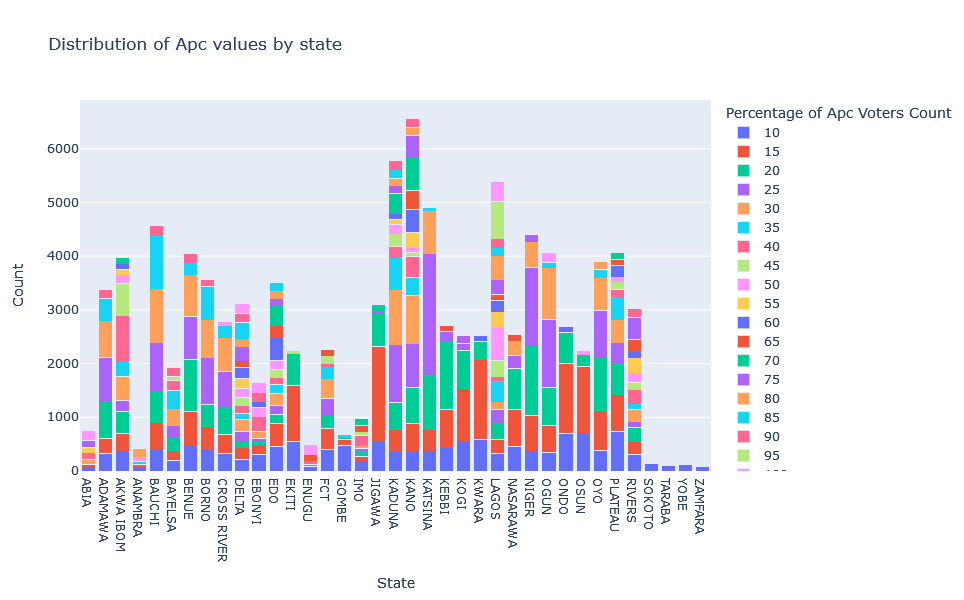

In [9]:
# assuming the dataframe with the Apc counts is named 'apc_pivot'
fig = px.bar(apc_pivot,
             x=apc_pivot.index,
             y=[10,15,20, 25,30,35,40,45,50,55,60,65,70,75,80,85,90,95,100], # replace with the actual Apc values in your data
             barmode='stack',
             labels={'value': 'Count', 'variable': 'Percentage of Apc Voters Count'},
             title='Distribution of Apc values by state')
fig.update_layout(width=800, height=600,)
fig.show()

# LP vs STATES

In [10]:
# assuming your dataframe is named 'df'
grouped = df.groupby(['State', 'LP']).size().reset_index(name='counts')

# group the data by state and Apc and sum the counts
lp_counts = grouped.groupby(['State', 'LP']).sum().reset_index()

# bin the Apc counts into percentiles
lp_counts['percentile'] = pd.cut(lp_counts['counts'], bins=[0,10, 20,30, 40,50, 60, 70, 80,90,100,110,120,130,140,150,160,170,180,190], labels=[10,15,20, 25,30,35,40,45,50,55,60,65,70,75,80,85,90,95,100])

# pivot the data to create a new dataframe with each percentile value as a separate column
lp_pivot = lp_counts.pivot_table(index='State', columns='percentile', values='counts', aggfunc=sum)

# fill in any missing values with 0
lp_pivot = lp_pivot.fillna(0)

# display the resulting dataframe
print(lp_pivot)


percentile     10    15    20   25   30   35   40   45   50   55   60   65  \
State                                                                        
ABIA          695  1251   379   32    0    0    0    0    0    0    0    0   
ADAMAWA       458   292   307  242  178  166   69    0  255    0    0    0   
AKWA IBOM     312   321   272  219  404  282  400  157  173  758  414    0   
ANAMBRA       650  1839  1063    0    0    0    0    0    0    0    0    0   
BAUCHI        338   105    51   68    0    0    0   74    0    0    0    0   
BAYELSA       286   250   232  207  177  217  131  156   86    0    0    0   
BENUE         516   679   766  687  490  581  184    0    0    0    0    0   
BORNO         124    50    46   36   50   51    0   72    0    0    0  118   
CROSS RIVER   585   679   601  515  314    0    0    0   88    0    0    0   
DELTA         524   660   835  588  322  454  130   80   82    0    0    0   
EBONYI        720  1484   269    0    0    0    0    0    0   91

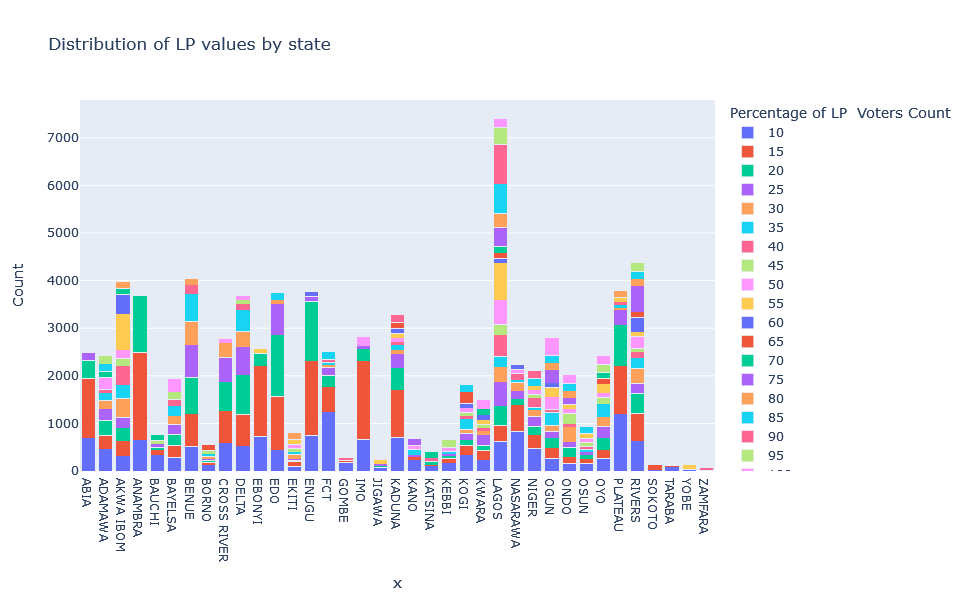

In [11]:
# assuming the dataframe with the Apc counts is named 'apc_pivot'
fig = px.bar(lp_pivot,
             x=apc_pivot.index,
             y=[10,15,20, 25,30,35,40,45,50,55,60,65,70,75,80,85,90,95,100], # replace with the actual Apc values in your data
             barmode='stack',
             labels={'value': 'Count', 'variable': 'Percentage of LP  Voters Count'},
             title='Distribution of LP values by state')
fig.update_layout(width=800, height=600,)
fig.show()

# PDP vs STATES

In [12]:
# assuming your dataframe is named 'df'
grouped = df.groupby(['State', 'PDP']).size().reset_index(name='counts')

# group the data by state and Apc and sum the counts
pdp_counts = grouped.groupby(['State', 'PDP']).sum().reset_index()

# bin the Apc counts into percentiles
pdp_counts['percentile'] = pd.cut(pdp_counts['counts'], bins=[0,10, 20,30, 40,50, 60, 70, 80,90,100,110,120,130,140,150,160,170,180,190], labels=[10,15,20, 25,30,35,40,45,50,55,60,65,70,75,80,85,90,95,100])

# pivot the data to create a new dataframe with each percentile value as a separate column
pdp_pivot = pdp_counts.pivot_table(index='State', columns='percentile', values='counts', aggfunc=sum)

# fill in any missing values with 0
pdp_pivot = pdp_pivot.fillna(0)

# display the resulting dataframe
print(pdp_pivot)


percentile    10    15    20    25    30    35   40   45   50   55   60   65  \
State                                                                          
ABIA         173    68    71   107    44   112  132   80    0    0    0  111   
ADAMAWA      552  1803   868     0     0     0    0    0    0    0    0    0   
AKWA IBOM    276   345   455   629   679  1171  317    0    0    0  107    0   
ANAMBRA       90    42    26    80     0     0   62    0    0   99    0    0   
BAUCHI       476   871  1320  1338   486     0   64    0    0    0    0    0   
BAYELSA      285   429   425   356   178   107    0    0    0    0    0    0   
BENUE        297   242   346   317   316   228  203  301   81   99  318  339   
BORNO        396   431   417   592   263   388   63  146  174  288  109    0   
CROSS RIVER  334   282   321   321   172   270  538  229  173    0    0    0   
DELTA        227   244   449   416   265   324  336  145  256  299    0    0   
EBONYI       162    45    75     0    91

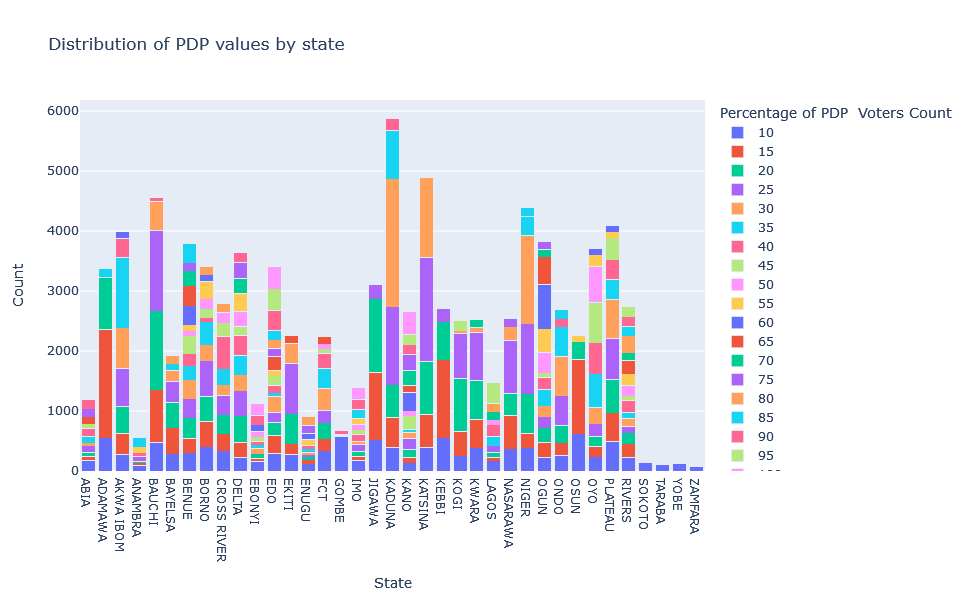

In [13]:
# assuming the dataframe with the Apc counts is named 'apc_pivot'
fig = px.bar(pdp_pivot,
             x=pdp_pivot.index,
             y=[10,15,20, 25,30,35,40,45,50,55,60,65,70,75,80,85,90,95,100], # replace with the actual Apc values in your data
             barmode='stack',
             labels={'value': 'Count', 'variable': 'Percentage of PDP  Voters Count'},
             title='Distribution of PDP values by state')
fig.update_layout(width=800, height=600,)
fig.show()

# NNPP vs STATES

In [14]:
# assuming your dataframe is named 'df'
grouped = df.groupby(['State', 'NNPP']).size().reset_index(name='counts')

# group the data by state and Apc and sum the counts
nnpp_counts = grouped.groupby(['State', 'NNPP']).sum().reset_index()

# bin the Apc counts into percentiles
nnpp_counts['percentile'] = pd.cut(nnpp_counts['counts'], bins=[0,10, 20,30, 40,50, 60, 70, 80,90,100,110,120,130,140,150,160,170,180,190], labels=[10,15,20, 25,30,35,40,45,50,55,60,65,70,75,80,85,90,95,100])

# pivot the data to create a new dataframe with each percentile value as a separate column
nnpp_pivot = nnpp_counts.pivot_table(index='State', columns='percentile', values='counts', aggfunc=sum)

# fill in any missing values with 0
nnpp_pivot = nnpp_pivot.fillna(0)

# display the resulting dataframe
print(nnpp_pivot)


percentile    10   15   20    25    30   35   40   45   50   55   60   65  \
State                                                                       
ABIA          17   31    0    38     0    0    0    0    0   96    0    0   
ADAMAWA       84   31   77     0    49   55    0   71    0    0    0    0   
AKWA IBOM     86   45   82    36     0   51    0   79   87    0    0    0   
ANAMBRA       24    0   27     0     0   58    0    0    0    0    0    0   
BAUCHI       249  247  112   243    45  168  198   80  176   92    0  119   
BAYELSA       24   13    0     0     0   54    0    0    0    0    0    0   
BENUE         52   14   23    35     0   55    0    0    0   93    0    0   
BORNO         41   48   49     0    41    0    0   78    0    0    0    0   
CROSS RIVER   23   13   21    38     0    0    0    0   82    0    0    0   
DELTA         36   17    0     0    42    0    0    0    0    0    0    0   
EBONYI        13   11   24     0    45    0   67    0    0    0    0    0   

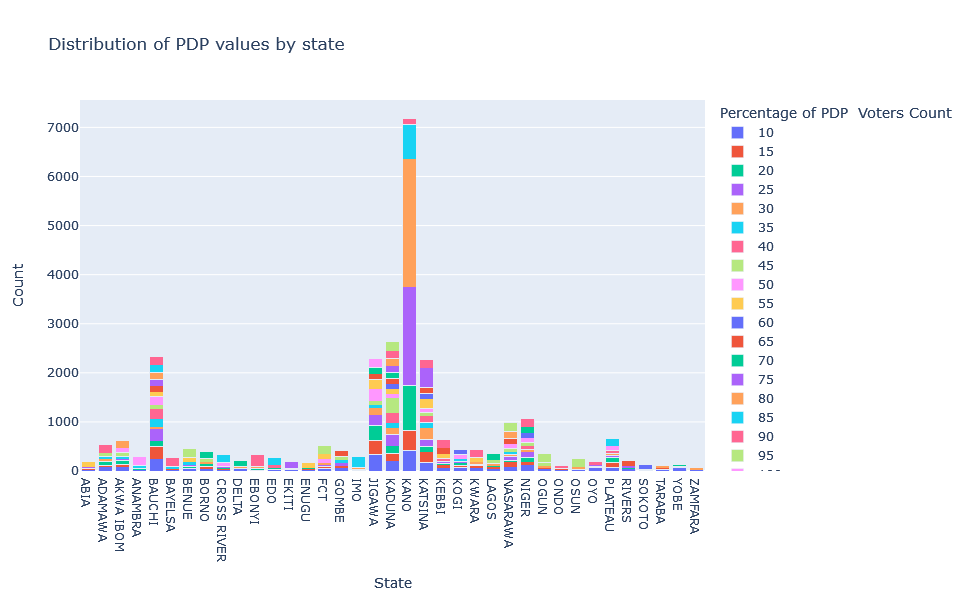

In [15]:
# assuming the dataframe with the Apc counts is named 'apc_pivot'
fig = px.bar(nnpp_pivot,
             x=nnpp_pivot.index,
             y=[10,15,20, 25,30,35,40,45,50,55,60,65,70,75,80,85,90,95,100], # replace with the actual Apc values in your data
             barmode='stack',
             labels={'value': 'Count', 'variable': 'Percentage of PDP  Voters Count'},
             title='Distribution of PDP values by state')
fig.update_layout(width=800, height=600,)
fig.show()

In [ ]:
# import plotly.express as px
# # df_ = px.data.gapminder().query("year == 2007").query("continent == 'Americas'")
# fig = px.pie(df['State'], values='pop', names='country',
#              title='Population of American continent',
#              hover_data=['lifeExp'], labels={'lifeExp':'life expectancy'})
# fig.update_traces(textposition='inside', textinfo='percent+label')
# fig.show


# fig = px.pie(df['State'], values='tip', names='APC')
# fig.show()

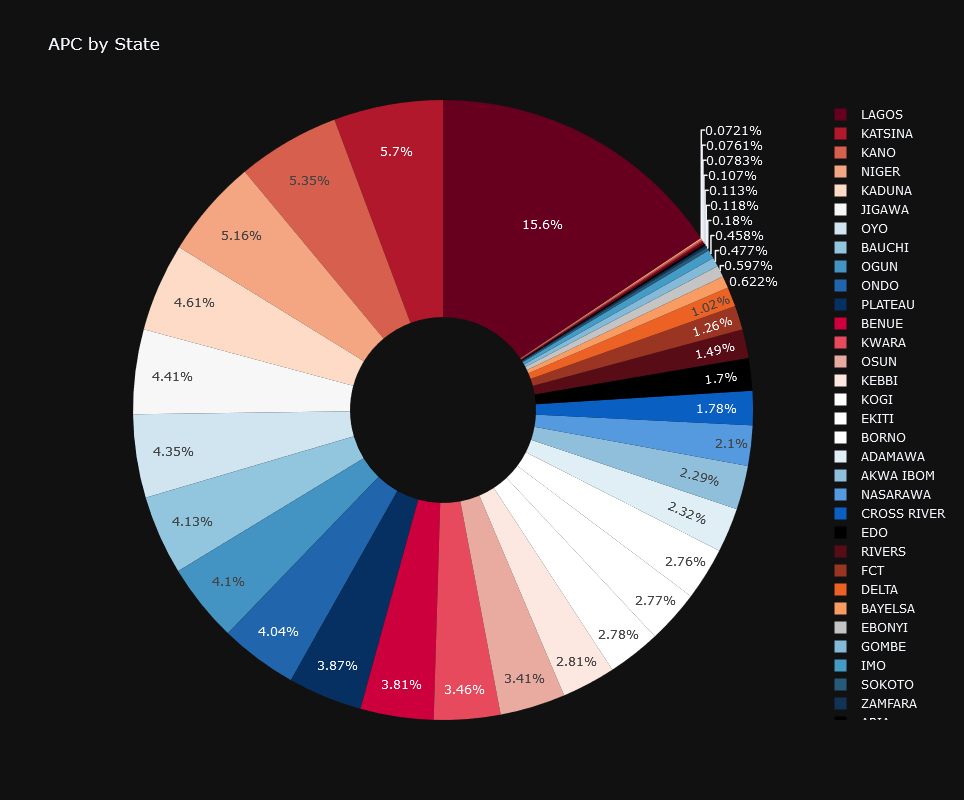

In [16]:
fig = px.pie(df, values='APC', names='State',
             title='APC by State', labels={'APC': 'Total Count of Votes'},
             width=800, height=800, hole=0.3,
             template='plotly_dark',
             color_discrete_sequence=px.colors.sequential.RdBu)

fig.show()

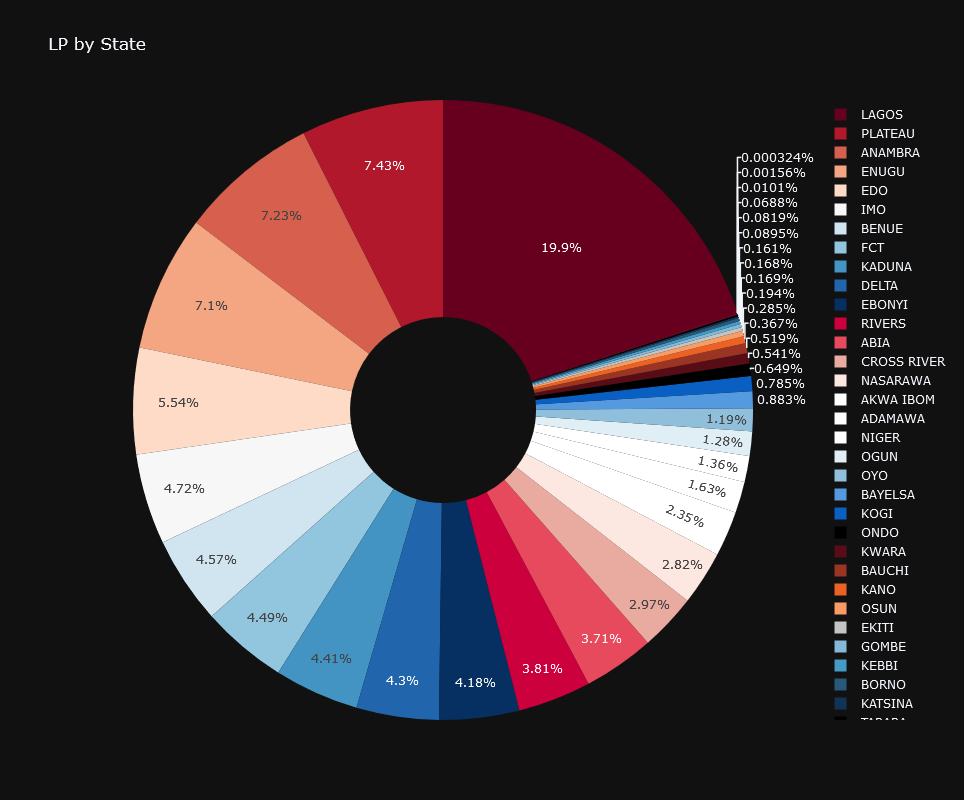

In [17]:
fig = px.pie(df, values='LP', names='State',
             title='LP by State', labels={'LP': 'Total Count of Votes'},
             width=800, height=800, hole=0.3,
             template='plotly_dark',
             color_discrete_sequence=px.colors.sequential.RdBu)

fig.show()

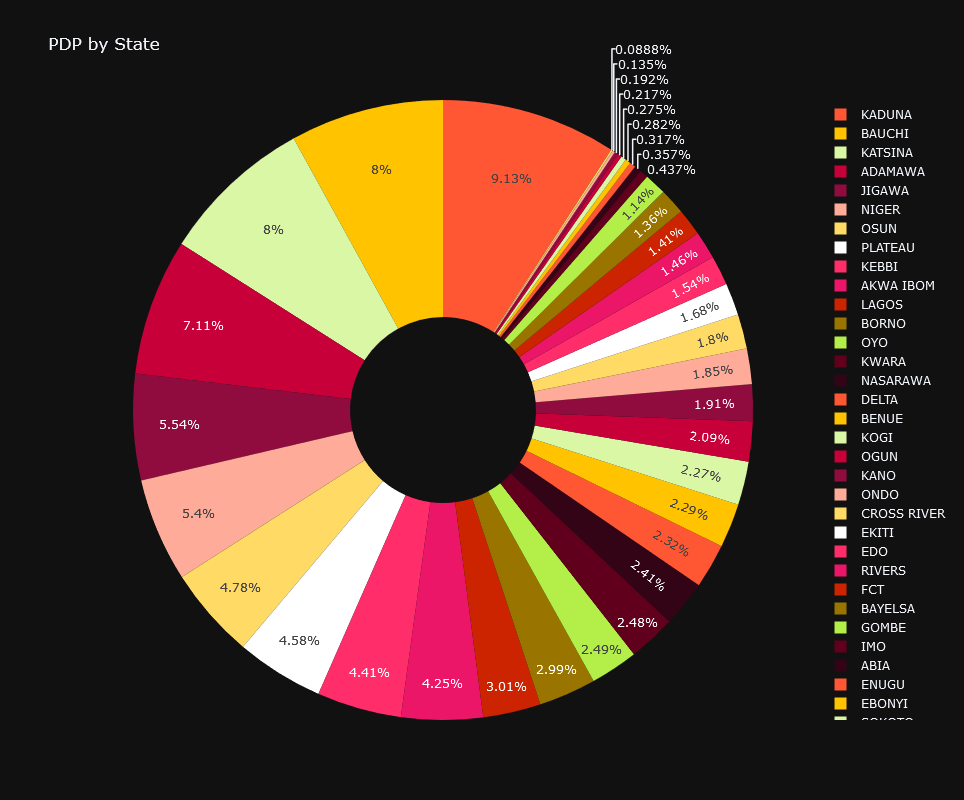

In [18]:
colors = ['#FF5733', '#FFC300', '#DAF7A6', '#C70039', '#900C3F']
fig = px.pie(df, values='PDP', names='State',
             title='PDP by State', labels={'PDP': 'Total Count of Votes'},
             width=800, height=800, hole=0.3,
             template='plotly_dark',
             color_discrete_sequence=colors)

fig.show()

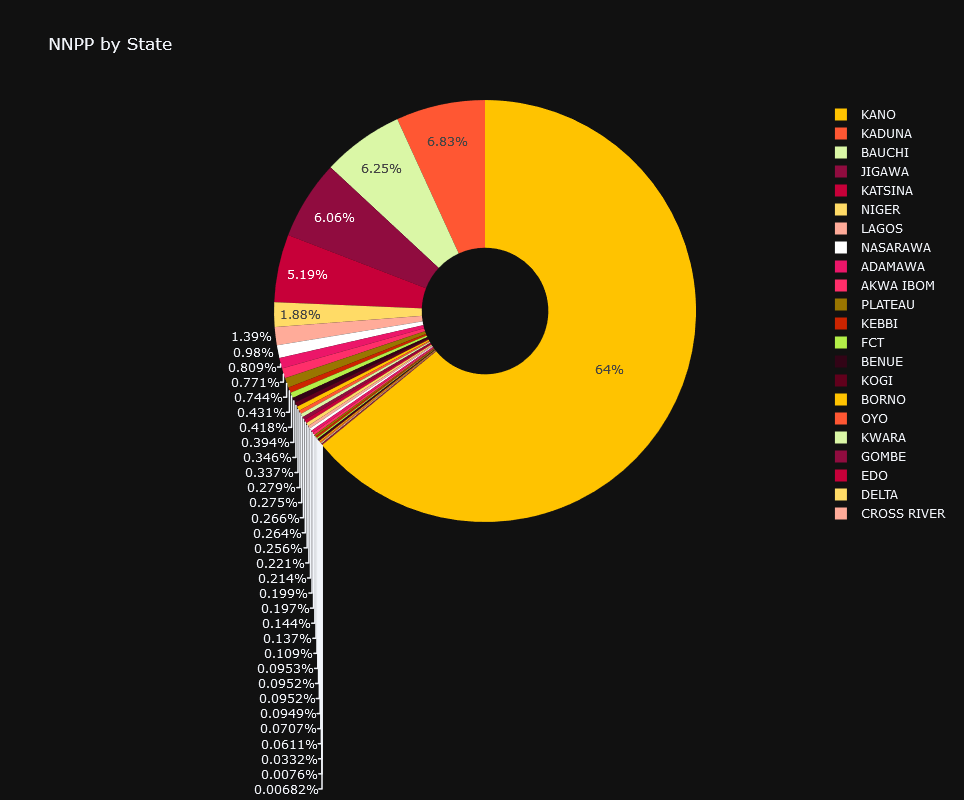

In [19]:
colors = ['#FFC300','#FF5733', '#DAF7A6','#900C3F','#C70039']
fig = px.pie(df, values='NNPP', names='State',
             title='NNPP by State', labels={'NNPP': 'Total Count of Votes'},
             width=800, height=800, hole=0.3,
             template='plotly_dark',
             color_discrete_sequence=colors)

fig.show()

# BARCHARTS OF EACH STATE BY VOTES IN EACH PARTY

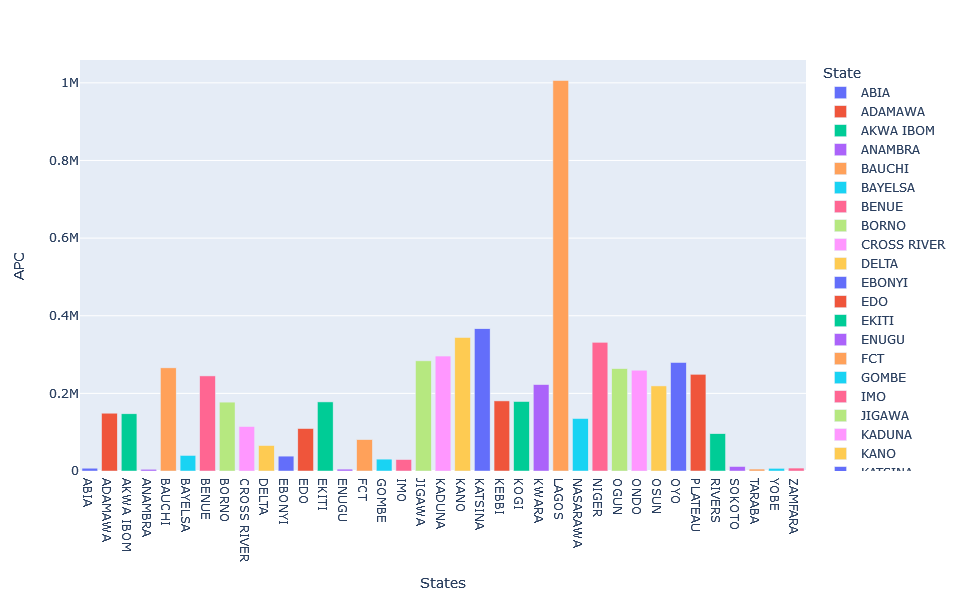

In [20]:
# group by State and aggregate APC values
grouped_df = df.groupby("State").agg({"APC": "sum"}).reset_index()

# create bar chart
fig = px.bar(grouped_df, x="State", y="APC", color="State")

# update axis labels
fig.update_xaxes(title_text="States")
fig.update_yaxes(title_text="APC")
fig.update_layout(width=800, height=600,)

# show chart
fig.show()

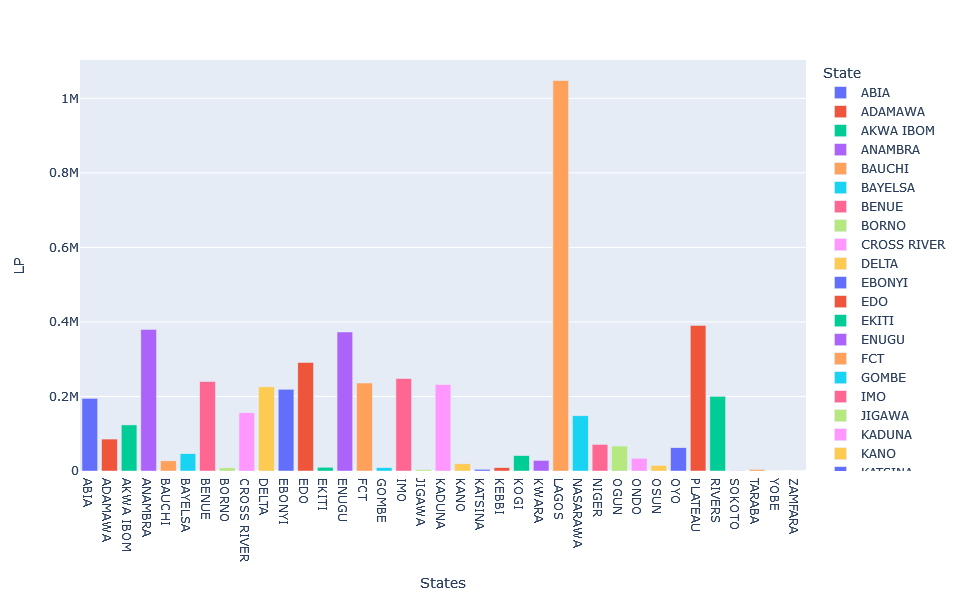

In [21]:
# group by State and aggregate APC values
grouped_df = df.groupby("State").agg({"LP": "sum"}).reset_index()

# create bar chart
fig = px.bar(grouped_df, x="State", y="LP", color="State")

# update axis labels
fig.update_xaxes(title_text="States")
fig.update_yaxes(title_text="LP")
fig.update_layout(width=800, height=600,)

# show chart
fig.show()

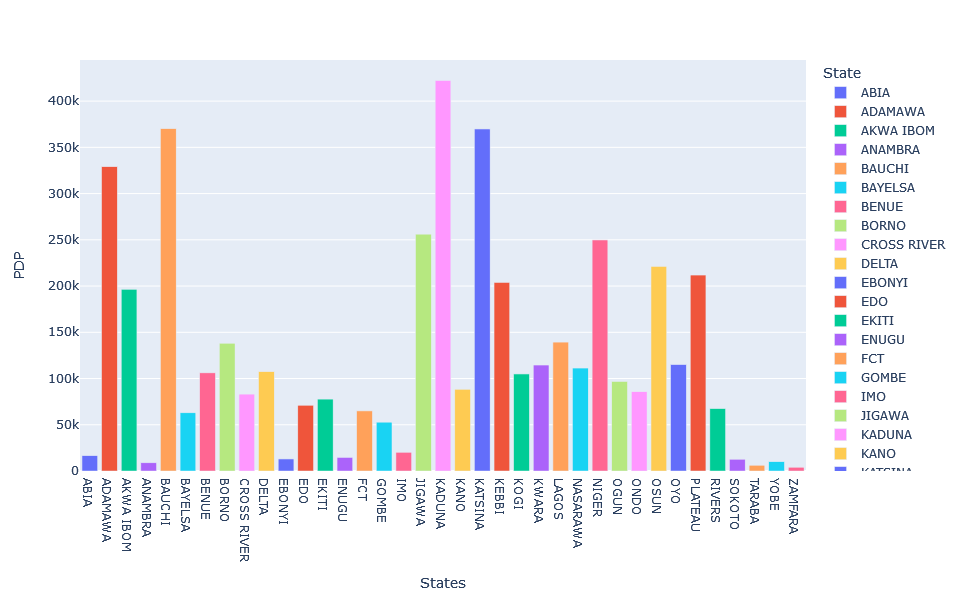

In [22]:
# group by State and aggregate APC values
grouped_df = df.groupby("State").agg({"PDP": "sum"}).reset_index()

# create bar chart
fig = px.bar(grouped_df, x="State", y="PDP", color="State")

# update axis labels
fig.update_xaxes(title_text="States")
fig.update_yaxes(title_text="PDP")
fig.update_layout(width=800, height=600,)
# show chart
fig.show()

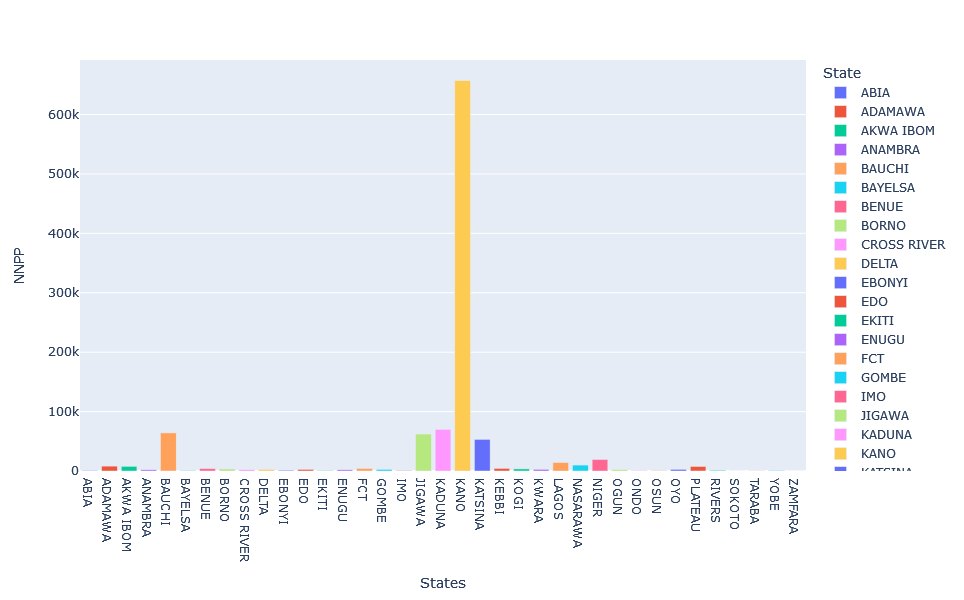

In [23]:
# group by State and aggregate APC values
grouped_df = df.groupby("State").agg({"NNPP": "sum"}).reset_index()

# create bar chart
fig = px.bar(grouped_df, x="State", y="NNPP", color="State")

# update axis labels
fig.update_xaxes(title_text="States")
fig.update_yaxes(title_text="NNPP")
fig.update_layout(width=800, height=600,)
# show chart
fig.show()

In [ ]:
# grouped_df = df.groupby(["State", "LGA"]).agg({"APC": "sum"}).reset_index()

# # create histogram chart
# fig = px.histogram(grouped_df, x="State", y="APC", color="LGA", 
#                    title="APC Votes by LGA in Each State")

# # update layout
# fig.update_layout(
#     width=800, # set width
#     height=600, # set height
# )

# # show chart
# fig.show()